<a href="https://colab.research.google.com/github/AYA0HASSAN/ImageStitching/blob/main/Stitching.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import cv2
import os
import random
import numpy as np
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import matplotlib.patches as patches


from google.colab.patches import cv2_imshow

### Part1:

Read Images

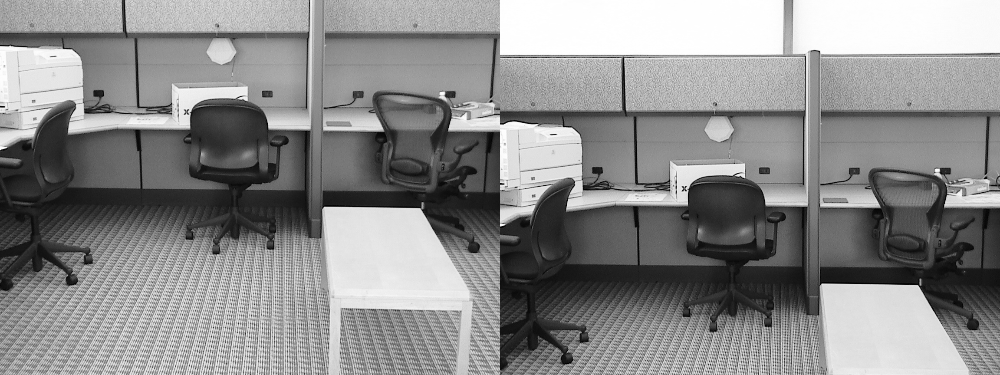

In [3]:
officeImg0 = cv2.imread('/content/office/office-00.png')
officeImg1 = cv2.imread('/content/office/office-01.png')
final_frame = cv2.hconcat([officeImg0,officeImg1])
cv2_imshow(final_frame)

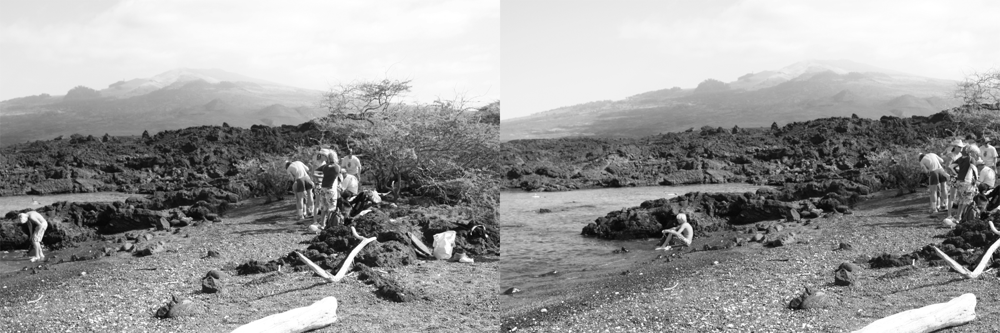

In [71]:
fishbowlImg0 = cv2.imread('/content/fishbowl/fishbowl-00.png')
fishbowlImg1 = cv2.imread('/content/fishbowl/fishbowl-01.png')
final_frame = cv2.hconcat([fishbowlImg0,fishbowlImg1])
cv2_imshow(final_frame)

In [5]:
print(f"Office Images Dimentions = {officeImg0.shape} and {officeImg1.shape}")
print(f"Fishbowl Images Dimentions = {fishbowlImg0.shape} and {fishbowlImg1.shape}")


Office Images Dimentions = (864, 1152, 3) and (864, 1152, 3)
Fishbowl Images Dimentions = (600, 900, 3) and (600, 900, 3)


Part 1 :
- Feature Detectors 

In [6]:
# convert images to gray scale
officeGrayImg0 = cv2.cvtColor(officeImg0, cv2.COLOR_BGR2GRAY)
officeGrayImg1 = cv2.cvtColor(officeImg1, cv2.COLOR_BGR2GRAY)


fishbowlGrayImg0 = cv2.cvtColor(fishbowlImg0, cv2.COLOR_BGR2GRAY)
fishbowlGrayImg1 = cv2.cvtColor(fishbowlImg1, cv2.COLOR_BGR2GRAY)

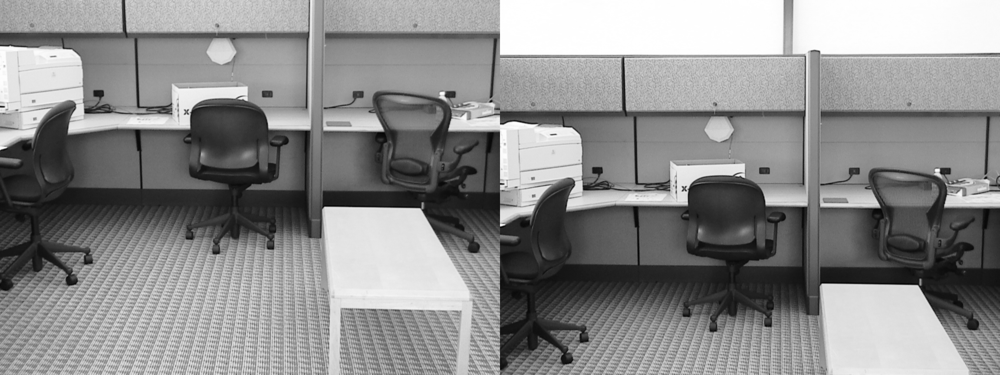

In [7]:
# Apply Gaussian filter to reduce noise

officeGrayGaussianImg0 = cv2.GaussianBlur(officeGrayImg0,(3,3),0)
officeGrayGaussianImg1 = cv2.GaussianBlur(officeGrayImg1,(3,3),0)

fishbowlGrayGaussianImg0 = cv2.GaussianBlur(fishbowlGrayImg0,(3,3),0)
fishbowlGrayGaussianImg1 = cv2.GaussianBlur(fishbowlGrayImg1,(3,3),0)

final_frame = cv2.hconcat([officeGrayGaussianImg0,officeGrayGaussianImg1])
cv2_imshow(final_frame)

### Oriented FAST and Rotated BRIEF (ORB)

In [12]:
# create Oriented FAST and Rotated BRIEF (ORB)
orb = cv2.ORB_create()
officeKeypoints0 , officeDescriptors0 = orb.detectAndCompute(officeGrayGaussianImg0,None)
officeKeypoints1 , officeDescriptors1 = orb.detectAndCompute(officeGrayGaussianImg1,None)

fishbowlKeypoints0 , fishbowlDescriptors0 = orb.detectAndCompute(fishbowlGrayGaussianImg0,None)
fishbowlKeypoints1 , fishbowlDescriptors1 = orb.detectAndCompute(fishbowlGrayGaussianImg1,None)


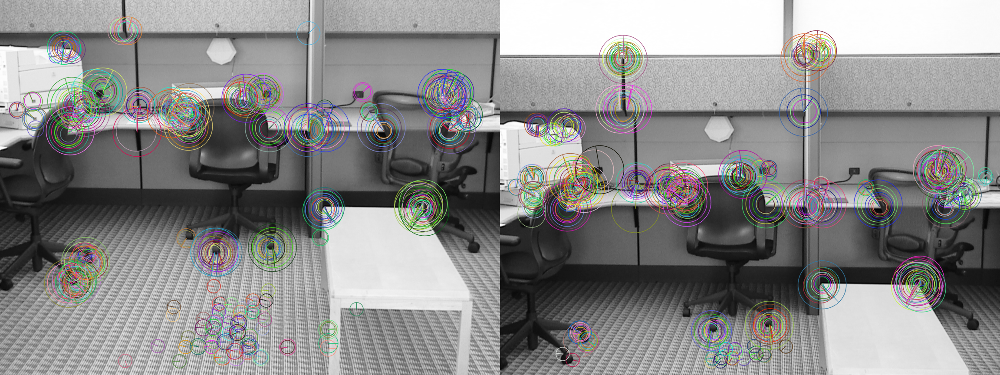

In [13]:

officeWithKeypoints0 = cv2.drawKeypoints(officeGrayGaussianImg0,officeKeypoints0 ,officeGrayGaussianImg0,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS) 
officeWithKeypoints1 = cv2.drawKeypoints(officeGrayGaussianImg1,officeKeypoints1 ,officeGrayGaussianImg1,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS) 

final_frame = cv2.hconcat([officeWithKeypoints0,officeWithKeypoints1])
cv2_imshow(final_frame)

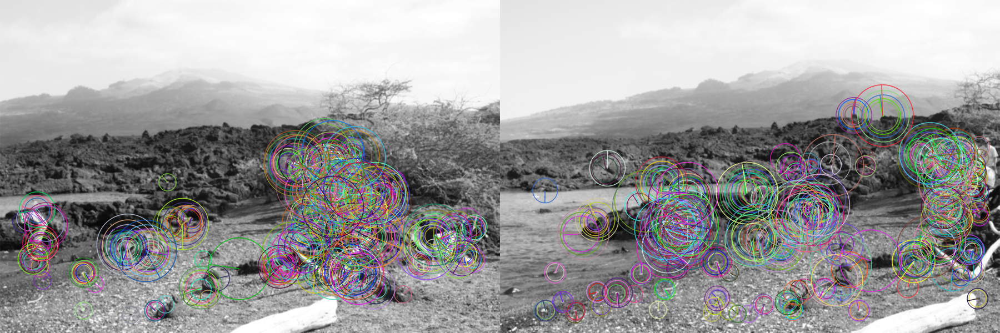

In [14]:
fishbowelWithKeypoints0 = cv2.drawKeypoints(fishbowlGrayGaussianImg0,fishbowlKeypoints0 ,fishbowlGrayGaussianImg0,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS) 
fishbowelWithKeypoints1 = cv2.drawKeypoints(fishbowlGrayGaussianImg1,fishbowlKeypoints1 ,fishbowlGrayGaussianImg1,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS) 

final_frame = cv2.hconcat([fishbowelWithKeypoints0,fishbowelWithKeypoints1])
cv2_imshow(final_frame)

###SIFT (Scale-Invariant Feature Transform) feature detectors

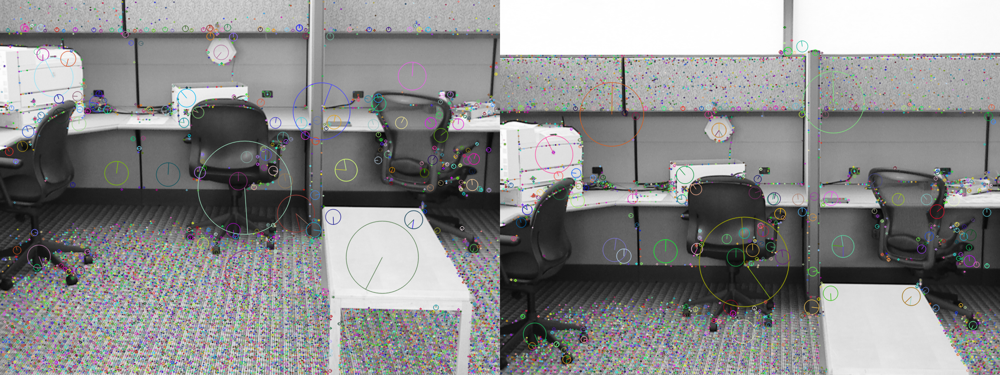

In [15]:
# Initialize SIFT detector
sift = cv2.SIFT_create()

# Detect keypoints and compute descriptors
officeKeypoints0 , officeDescriptors0 = sift.detectAndCompute(officeGrayGaussianImg0,None)
officeKeypoints1 , officeDescriptors1 = sift.detectAndCompute(officeGrayGaussianImg1,None)

fishbowlKeypoints0 , fishbowlDescriptors0 = sift.detectAndCompute(fishbowlGrayGaussianImg0,None)
fishbowlKeypoints1 , fishbowlDescriptors1 = sift.detectAndCompute(fishbowlGrayGaussianImg1,None)


officeWithKeypoints0 = cv2.drawKeypoints(officeGrayGaussianImg0,officeKeypoints0 ,officeGrayGaussianImg0,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS) 
officeWithKeypoints1 = cv2.drawKeypoints(officeGrayGaussianImg1,officeKeypoints1 ,officeGrayGaussianImg1,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS) 

final_frame = cv2.hconcat([officeWithKeypoints0,officeWithKeypoints1])
cv2_imshow(final_frame)

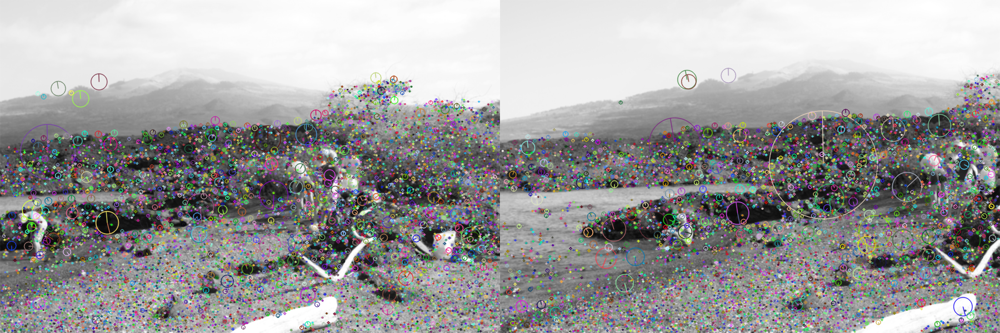

In [16]:
fishbowelWithKeypoints0 = cv2.drawKeypoints(fishbowlGrayGaussianImg0,fishbowlKeypoints0 ,fishbowlGrayGaussianImg0,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS) 
fishbowelWithKeypoints1 = cv2.drawKeypoints(fishbowlGrayGaussianImg1,fishbowlKeypoints1 ,fishbowlGrayGaussianImg1,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS) 

final_frame = cv2.hconcat([fishbowelWithKeypoints0,fishbowelWithKeypoints1])
cv2_imshow(final_frame)

I don't Know if it right or wrong but I feel that SIFT get better maybe more keypoints so I'll use it

###Drowing Matches between each pair

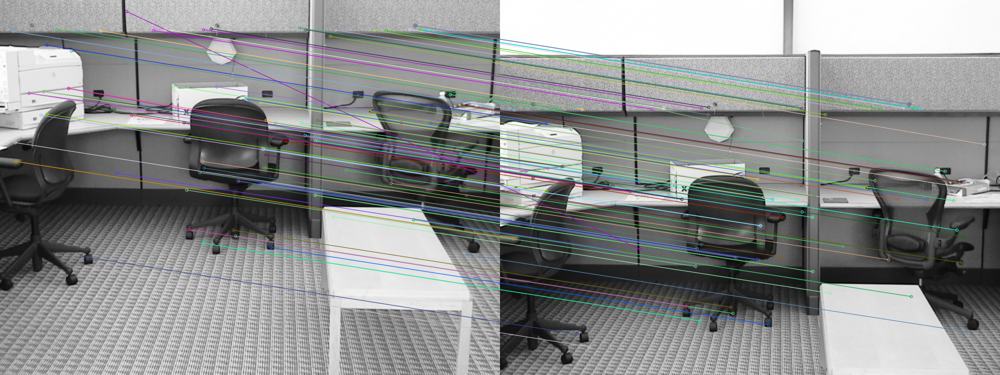

In [18]:
# Create Brute-Force Matcher  
bfmatcher = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)

# Office Image 
officeMatches = bfmatcher.match(officeDescriptors0, officeDescriptors1)
# Sort matches by distance , Best come first
officeMatches = sorted(officeMatches, key = lambda x: x.distance) 
officeImgMatches = cv2.drawMatches(officeGrayGaussianImg0, officeKeypoints0, officeGrayGaussianImg1, officeKeypoints1, officeMatches[:100], officeGrayGaussianImg1, flags=2) 
cv2_imshow(officeImgMatches)

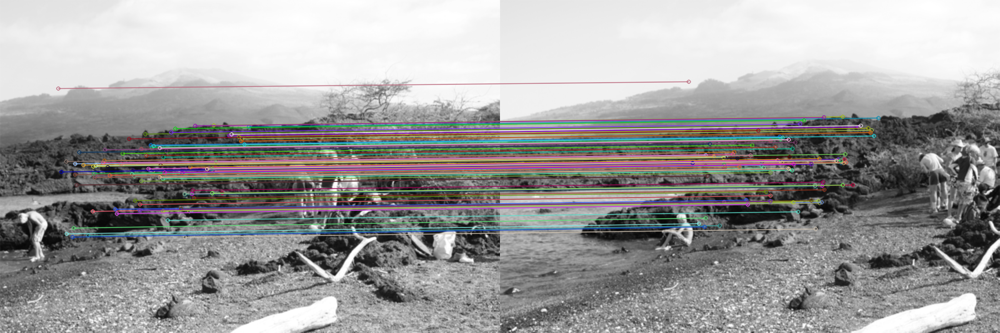

In [19]:
# Fishbowel Image 
fishbowelMatches = bfmatcher.match(fishbowlDescriptors0, fishbowlDescriptors1)
# Sort matches by distance , Best come first
fishbowelMatches = sorted(fishbowelMatches, key = lambda x: x.distance) 
fishbowelImgMatches = cv2.drawMatches(fishbowlGrayGaussianImg0, fishbowlKeypoints0, fishbowlGrayGaussianImg1, fishbowlKeypoints1, fishbowelMatches[:100], fishbowlGrayGaussianImg1, flags=2) 
cv2_imshow(fishbowelImgMatches)

### Part 2 :

In [20]:
def getMatches(img1,keypoints1,descriptors1,img2,keypoints2,descriptors2,threshold):
  bfmatcher = cv2.BFMatcher()
  matches = bfmatcher.knnMatch(descriptors1,descriptors2, k= 2)
  
  acceptedMatch = []
  for m,n in matches:
    if m.distance < threshold * n.distance :
      acceptedMatch.append([m])
  matches = []
  for pair in acceptedMatch:
     matches.append(list(keypoints1[pair[0].queryIdx].pt + keypoints2[pair[0].trainIdx].pt))
  matches = np.array(matches)
  return matches

In [65]:

def createSIFT(grayImg):
  """
    Input : image where it 2D or 3D 
    Output : keypoints and descriptors of that image
    Usage : constract keypoints and descriptors using SIFT algorithm of an image  
   """
  sift = cv2.SIFT_create()
  # Detect keypoints and compute descriptors
  keypoints , descriptors = sift.detectAndCompute(grayImg,None)
  return keypoints , descriptors


def createMatches(descriptors1,descriptors2):
   """
    Input : descriptors of 2 images  
    Output : matches between 2 images
    Usage : constract SIFT matches between 2 images  
   """
   matcher = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    # Match keypoints between the two images
   matches = matcher.match(descriptors1, descriptors2)
   return matches

def randomizedPoints(matches,keypoints1,keypoints2,sampleSize = 4):
  """
  Input : 
        matches => from createMatches function ,
        keypoints1,keypoints1 => from createSIFT function of 2 images
        sampleSize => no. of points in each image
  
  Usage : random points in both keypoints using matches between 2 images 
  """
  
  idx = np.random.choice(len(matches),size = sampleSize,replace = False)
  # print(idx)
  points1 = np.float32([keypoints1[matches[idx[m]].queryIdx].pt for m in range(sampleSize)])
  points2 = np.float32([keypoints2[matches[idx[m]].trainIdx].pt for m in range(sampleSize)])
  return points1,points2

def RANSAC(matches,keypoints1,keypoints2,iterations,inlierThreshold,pointsNumber = 4):
  """
  Input : 
        matches => from createMatches function ,
        keypoints1,keypoints1 => from createSIFT function of 2 images
        iterations => no.of iterations
        inlierThreshold => that is error threshold
  Output : 
        bestH => hemography matrix from points in matches 
        H => hemography matrix from points in bestInliers

  Usage : constract Homography matrix H using RANSAC algorithm
  """
  
  bestInliers = []
  for i in range(iterations):
    
    points1 , points2  = randomizedPoints(matches , keypoints1,keypoints2)
    # Compute homography from random matches
    H, mask = cv2.findHomography(points1,points2,cv2.RANSAC,inlierThreshold)

    points1Hat = cv2.perspectiveTransform(np.array([keypoints1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2), H)

    errors = np.linalg.norm(points1Hat - np.array([keypoints2[m.trainIdx].pt for m in matches]).reshape(-1,1,2),axis = -1)

    inliers = np.where(errors < inlierThreshold)[0]

    if len(inliers) > len(bestInliers):
      bestH = H
      bestInliers = inliers
  # Re-estimate homography using all inliers
    points1 = np.float32([keypoints1[matches[m].queryIdx].pt for m in bestInliers.astype(np.int32)])
    points2 = np.float32([keypoints2[matches[m].trainIdx].pt for m in bestInliers.astype(np.int32)])

    H, mask = cv2.findHomography(points1, points2, cv2.RANSAC, inlierThreshold)
  return  bestH , H  

def LeastMedianSquares(matches,keypoints1,keypoints2,iterations,inlierThreshold,pointsNumber = 4):
  
  """
  Input : 
        matches => from createMatches function ,
        keypoints1,keypoints1 => from createSIFT function of 2 images
        iterations => no.of iterations
        inlierThreshold => that is error threshold
  Output : 
        bestH => hemography matrix from points in matches 
        H => hemography matrix from points in bestInliers

  Usage : constract Homography matrix H using Least Median Squares in calculating error 
  """

  bestInliers = []

  for i in range(iterations):
    
    points1,points2 = randomizedPoints(matches,keypoints1,keypoints2)
    H, mask = cv2.findHomography(points1, points2, cv2.RANSAC, inlierThreshold)

    points1Hat = cv2.perspectiveTransform(np.array([keypoints1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2), H)
    errors = np.linalg.norm(points1Hat - np.array([keypoints2[m.trainIdx].pt for m in matches]).reshape(-1,1,2),axis = -1)

    medianError = np.median(errors)

    inliers = np.where(errors <= medianError)[0]

    if len(inliers) > len(bestInliers):
      bestH = H
      bestInliers = inliers
   # Re-estimate homography using all inliers
    points1 = np.float32([keypoints1[matches[m].queryIdx].pt for m in bestInliers.astype(np.int32)])
    points2 = np.float32([keypoints2[matches[m].trainIdx].pt for m in bestInliers.astype(np.int32)])

    H, mask = cv2.findHomography(points1, points2, cv2.RANSAC, inlierThreshold)
  return bestH , H  

def Stitch(img1, img2, H):
    """
    Input : 2 3D images RGB or BGR and Homography matrix
    Output : only one 3D image RGB or BGR same as Input with different dimentions 
    Usage : to stitch 2 images using Homography matrix H
    """
    width = img1.shape[1] + img2.shape[1]
    height = img1.shape[0] + img2.shape[0]

    result = cv2.warpPerspective(img1, H, (width, height))
    result[0:img2.shape[0], 0:img2.shape[1]] = img2
    return result

def cropImg(img):
  """
  Input : 3D image RGB or BGR
  Output : 3D image RGB or BGR same as Input
  Usage : to crop black region from stitched image
  """
  gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
  _,thresh = cv2.threshold(gray,1,255,cv2.THRESH_BINARY)

  contours,hierarchy = cv2.findContours(thresh,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
  cnt = contours[0]
  x,y,w,h = cv2.boundingRect(cnt)
  crop = img[y:y+h,x:x+w]
  return crop

In [68]:
def stitchingImages(imgPath0,imgPath1):
  imgOriginal0 = cv2.imread(imgPath0)
  imgOriginal1 = cv2.imread(imgPath1)

  # Convert Image to Gray  Scale
  imgGray0 = cv2.cvtColor(imgOriginal0, cv2.COLOR_BGR2GRAY)
  imgGray1 = cv2.cvtColor(imgOriginal1, cv2.COLOR_BGR2GRAY)

  # Apply Gaussian Filter "for smoothing/ remove noise"
  imgGrayGaussian0 = cv2.GaussianBlur(imgGray0,(3,3),0)
  imgGrayGaussian1 = cv2.GaussianBlur(imgGray1,(3,3),0)
  
  # get keypoints and descriptors
  keypoints0 , descriptors0  = createSIFT(imgGrayGaussian0)
  keypoints1 , descriptors1  = createSIFT(imgGrayGaussian1)
  
  # get Matches between 2 images 
  matches = createMatches(descriptors0,descriptors1)

  # get H and Inliers points
  # set iterations = 2000 & threshold = 0.4
  iterations = 2000 
  threshold = 0.4
  # Using RANSAC algorithm
  RANSACbestH , RANSAC_H = RANSAC(matches,keypoints0,keypoints1,iterations,threshold)

  # using LeastMedianSquares
  medLSbestH , medLS_H = LeastMedianSquares(matches,keypoints0,keypoints1,iterations,threshold)

  # stitching 2 images using each H has been constructed in RANSAC 

  RANSAC_H_img = Stitch(imgOriginal0,imgOriginal1,RANSAC_H)
  RANSAC_bestH_img= Stitch(imgOriginal0,imgOriginal1,RANSACbestH)

  RANSAC_H_imgCrop = cropImg(RANSAC_H_img)
  RANSAC_bestH_imgCrop = cropImg(RANSAC_bestH_img)

  # RANSACimages = cv2.hconcat([RANSAC_H_imgCrop,RANSAC_bestH_imgCrop])

  # stitching 2 images using each H has been constructed in LeastMedianSquares

  medLS_H_img = Stitch(imgOriginal0,imgOriginal1,medLS_H)
  medLS_bestH_img = Stitch(imgOriginal0,imgOriginal1,medLSbestH)

  medLS_H_imgCrop = cropImg(medLS_H_img)
  medLS_bestH_imgCrop = cropImg(medLS_bestH_img)

  # medLSimages = cv2.hconcat([medLS_H_imgCrop,medLS_bestH_imgCrop])

  # finalImage = cv2.vconcat([RANSACimages,medLSimages])
  return RANSAC_H_imgCrop,RANSAC_bestH_imgCrop,medLS_H_imgCrop,medLS_bestH_imgCrop


In [79]:
RANSAC_H_imgCropOffice,RANSAC_bestH_imgCropOffice,medLS_H_imgCropOffice,medLS_bestH_imgCropOffice = stitchingImages('/content/office/office-00.png','/content/office/office-01.png')


In [80]:
RANSAC_H_imgCropFishbowl,RANSAC_bestH_imgCropFishbowl,medLS_H_imgCropFishbowl,medLS_bestH_imgCropFishbowl = stitchingImages('/content/fishbowl/fishbowl-00.png','/content/fishbowl/fishbowl-01.png')


## Visualize 2 Images result from each Homography matrix H

In [74]:
def concatImages(img1,img2):

  # Get the dimensions of the two images
  h1, w1, _ = img1.shape
  h2, w2, _ = img2.shape

  # Find the maximum height and resize the images to have the same height
  max_height = max(h1, h2)
  img1_resized = cv2.resize(img1, (int(w1 * max_height / h1), max_height))
  img2_resized = cv2.resize(img2, (int(w2 * max_height / h2), max_height))
  return img1_resized , img2_resized

###Office

RANSAC

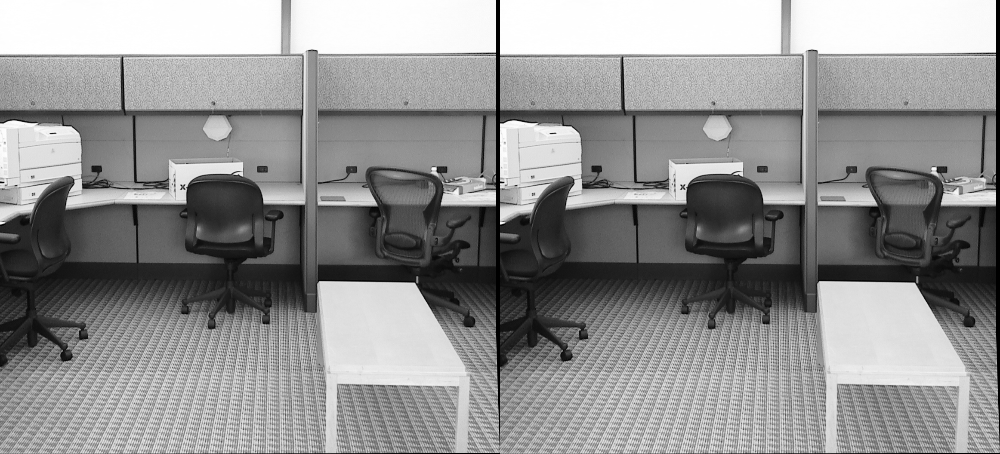

In [81]:
RANSAC1 , RANSAC1 = concatImages(RANSAC_H_imgCropOffice,RANSAC_bestH_imgCropOffice)
final_frame = cv2.hconcat([RANSAC1 , RANSAC1])
cv2_imshow(final_frame)

MedianLeastSquare

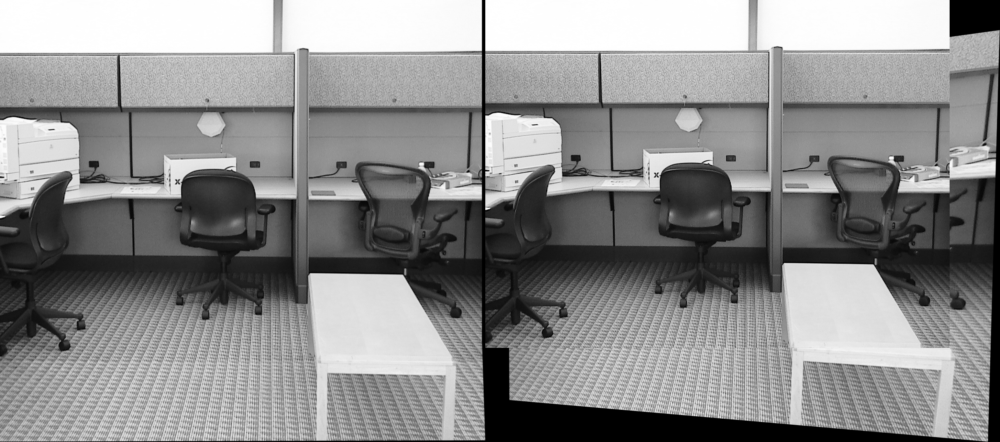

In [82]:
medLS1,medLS2= concatImages(medLS_H_imgCropOffice,medLS_bestH_imgCropOffice)
final_frame = cv2.hconcat([medLS1,medLS2])
cv2_imshow(final_frame)


###Fishbowl

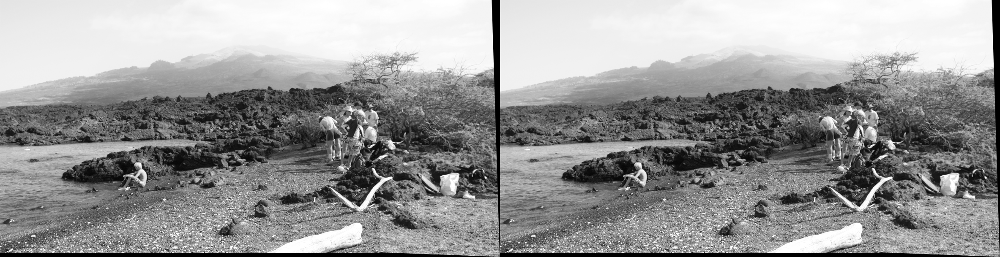

In [83]:
RANSAC1 , RANSAC1 = concatImages(RANSAC_H_imgCropFishbowl,RANSAC_bestH_imgCropFishbowl)
final_frame = cv2.hconcat([RANSAC1 , RANSAC1])
cv2_imshow(final_frame)

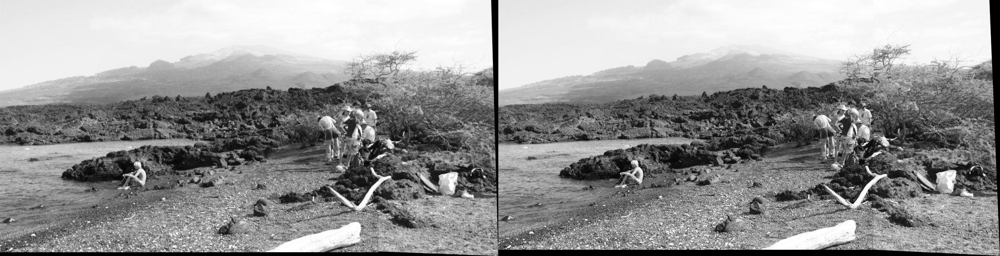

In [84]:
medLS1,medLS2= concatImages(medLS_H_imgCropFishbowl,medLS_bestH_imgCropFishbowl)
final_frame = cv2.hconcat([medLS1,medLS2])
cv2_imshow(final_frame)
